In [23]:
from transformers import pipeline
import requests
from PIL import Image, ImageDraw, ImageFont
import io
from IPython.display import display

print("Bibliotecas importadas com sucesso!")

Bibliotecas importadas com sucesso!


In [ ]:
print("Carregando o modelo de detecção de objetos... Isso pode demorar na primeira vez.")

detector = pipeline("object-detection", model="facebook/detr-resnet-50")
print("Modelo carregado!")

In [29]:
url_com_carro = "https://images.pexels.com/photos/170811/pexels-photo-170811.jpeg"

url_sem_carro = "https://images.pexels.com/photos/1197095/pexels-photo-1197095.jpeg"

url_selecionada = url_com_carro
# url_selecionada = url_sem_carro

try:
    response = requests.get(url_selecionada)
    response.raise_for_status()

    imagem = Image.open(io.BytesIO(response.content))

    print("Imagem carregada com sucesso!")

    # display(imagem)

except requests.exceptions.RequestException as e:
    print(f"Erro ao baixar a imagem: {e}")

Imagem carregada com sucesso!


In [27]:
def desenhar_deteccoes(img, resultados, confianca_minima=0.9):
    
    imagem_com_desenho = img.copy()
    
    draw = ImageDraw.Draw(imagem_com_desenho)
    
    try:
        fonte = ImageFont.truetype("DejaVuSans.ttf", size=20)
    except IOError:
        print("Fonte 'DejaVuSans.ttf' não encontrada, usando a fonte padrão.")
        fonte = ImageFont.load_default()

    print(f"\nDesenhando os carros encontrados com confiança >= {confianca_minima*100}%...")
    
    for obj in resultados:
        if obj['label'] == 'car' and obj['score'] >= confianca_minima:
            box = obj['box']
            xmin = box['xmin']
            ymin = box['ymin']
            xmax = box['xmax']
            ymax = box['ymax']

            texto_label = f"{obj['label']}: {obj['score']:.2f}"

            draw.rectangle([(xmin, ymin), (xmax, ymax)], outline="red", width=3)
 
            posicao_texto = (xmin, ymin - 25)
            
            draw.text(posicao_texto, texto_label, fill="red", font=fonte)
            
            print(f"- Carro detectado com score {obj['score']:.2f} na posição {box}")

    display(imagem_com_desenho)


Desenhando os carros encontrados com confiança >= 90.0%...
- Carro detectado com score 1.00 na posição {'xmin': 425, 'ymin': 331, 'xmax': 4588, 'ymax': 2470}


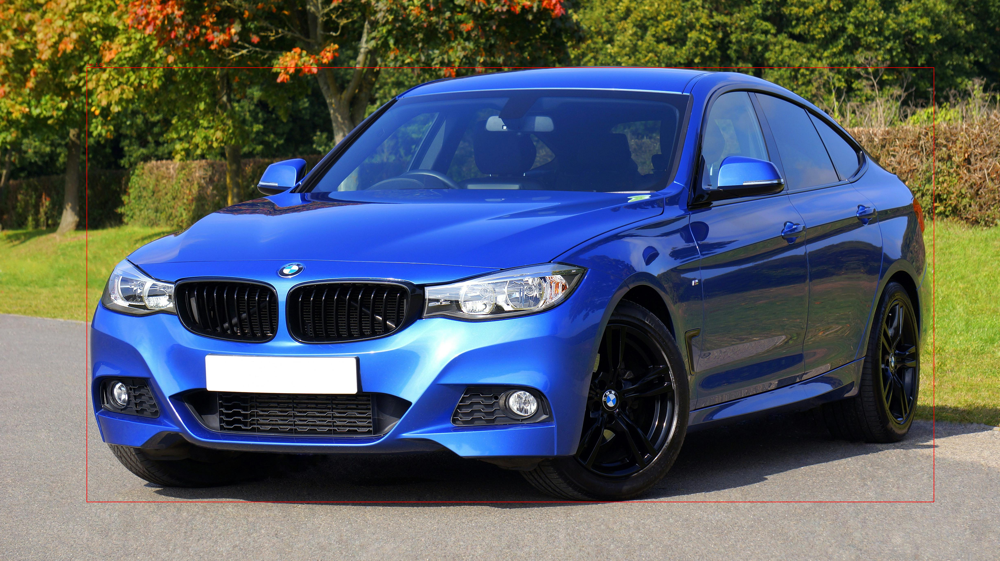

In [30]:
resultados = detector(imagem)

desenhar_deteccoes(imagem, resultados)